In [62]:
import numpy as np
import matplotlib.pyplot as plt
from numba import jit
import matplotlib as mpl
from tqdm.notebook import tqdm

In [78]:
@jit(nopython=True)
def RK4_ZZ(f, y0, t, args=()):
    n = len(t)
    y = np.zeros((n, len(y0)))
    Etheta = np.exp(1j*y0)
    Na = args[0]
    EA,EB = Etheta[:Na],Etheta[Na:]
    Z1a,Z2a = get_ZE12(EA)
    Z1b,Z2b = get_ZE12(EB)
    Z1as = np.zeros(n,dtype=np.complex64)
    Z1bs = np.zeros(n,dtype=np.complex64)
    Z2as = np.zeros(n,dtype=np.complex64)
    Z2bs = np.zeros(n,dtype=np.complex64)

    Z1as[0] = Z1a
    Z2as[0] = Z2a
    Z1bs[0] = Z1b
    Z2bs[0] = Z2b
    
    y[0] = y0
    
    for i in range(n - 1):
        h = t[i + 1] - t[i]
        k1,Z1a,Z1b,Z2a,Z2b = f(y[i], t[i], *args)
        k2,_,_,_,_ = f(y[i] + k1 * h / 2.0, t[i] + h / 2.0, *args)
        k3,_,_,_,_ = f(y[i] + k2 * h / 2.0, t[i] + h / 2.0, *args)
        k4,_,_,_,_ = f(y[i] + k3 * h, t[i] + h, *args)
        y[i + 1] = y[i] + (h / 6.0) * (k1 + 2 * k2 + 2 * k3 + k4)
        Z1as[i+1],Z1bs[i+1],Z2as[i+1],Z2bs[i+1] = Z1a,Z1b,Z2a,Z2b
    return y,(Z1as,Z1bs,Z2as,Z2bs)
@jit(nopython=True)
def get_ZE12(Etheta):
    ''' get theta and return r and theta'''
    E1 = Etheta
    E2 = E1**2
    Z1,Z2 = np.mean(E1),np.mean(E2)
    return Z1,Z2

@jit(nopython=True)
def Kuramoto_MF_CHIMERA(Theta,t,Na,Nb,beta,alpha,K):
    dtheta = np.zeros(Na+Nb)

    Etheta = np.exp(1j*Theta)
    EA,EB = Etheta[:Na],Etheta[Na:]
    Z1a,Z2a = get_ZE12(EA)
    Z1b,Z2b = get_ZE12(EB)
    A = np.exp(-1j*alpha)
    EA,EB = np.conjugate(EA), np.conjugate(EB)
    ZZa =  (Z1a+beta*Z1b)
    ZZb =  (Z1b+beta*Z1a)
    dtheta[:Na] = K*((A*(ZZa**2-Z2a/Na - beta*Z2b/Nb))*EA*EA -(2*A/Na*ZZa)*EA).imag
    dtheta[Na:] = K*((A*(ZZb**2-Z2b/Nb - beta*Z2a/Na))*EB*EB -(2*A/Nb*ZZb)*EB).imag
    return dtheta,Z1a,Z1b,Z2a,Z2b

# @jit(nopython=True)
# def Kuramoto_MF_CHIMERA(Theta,t,Na,Nb,beta,alpha,K):
#     dtheta = np.zeros(Na+Nb)

#     Etheta = np.exp(1j*Theta)
#     EA,EB = Etheta[:Na],Etheta[Na:]
#     Z1a,Z2a = get_ZE12(EA)
#     Z1b,Z2b = get_ZE12(EB)
#     A = np.exp(-1j*alpha)
#     EA,EB = np.conjugate(EA), np.conjugate(EB)
#     ZZa =  K*(Z1a+beta*Z1b)
#     ZZb =  K*(Z1b+beta*Z1a)
#     dtheta[:Na] = ((A*(ZZa**2))*EA*EA).imag
#     dtheta[Na:] = ((A*(ZZb**2))*EB*EB).imag
#     return dtheta,Z1a,Z1b,Z2a,Z2b

In [79]:
Theta[:N1//2] = np.random.uniform(0,np.pi,N1//2)
Theta[N1//2:N1] = np.random.uniform(np.pi,2*np.pi,N1//2)
Theta[N1:N1+N2//2] = np.random.uniform(0,np.pi,N1//2)
Theta[N1+N2//2:] = np.random.uniform(np.pi,2*np.pi,N1//2)

In [80]:
Theta[N1:N1+N2//2]

array([2.55052932, 2.74877308, 2.16271402, 1.78911946, 0.50570668,
       1.46674685, 1.08438998, 0.70698388, 1.86143093, 0.98102463,
       2.8786588 , 2.85770428, 0.80776094, 0.3483753 , 0.6062103 ,
       1.56948996, 2.28891938, 0.65406212, 0.7792204 , 2.67560611,
       1.30642728, 1.93737328, 0.73408383, 0.32033959, 1.62061261,
       1.49898262, 0.47963212, 1.95346189, 1.70905819, 2.05503308,
       0.45410321, 2.36099427, 0.69758795, 1.63159188, 2.46708023,
       0.07015311, 1.01901472, 2.74236652, 2.6537335 , 1.69156101,
       2.72253019, 2.98390352, 2.59623415, 2.6832828 , 0.31021155,
       2.04613291, 2.2101638 , 1.91712805, 2.51206543, 0.10860869,
       2.41977635, 2.2987932 , 0.81586656, 0.80760702, 1.98643946,
       1.08478397, 2.50255714, 1.40160972, 2.45907981, 3.11165888,
       0.94325798, 0.44926606, 2.83154396, 1.70135897, 3.06223719,
       1.99995171, 3.12246986, 1.71553203, 1.65381585, 0.42545931,
       1.11748075, 0.08236806, 0.50389632, 2.34248833, 0.09550

In [81]:
num = 1
R1s,R2s = [], []
Q1s,Q2s = [], []

In [82]:
num = num - 1

1.0 0.7995341 0.20046592


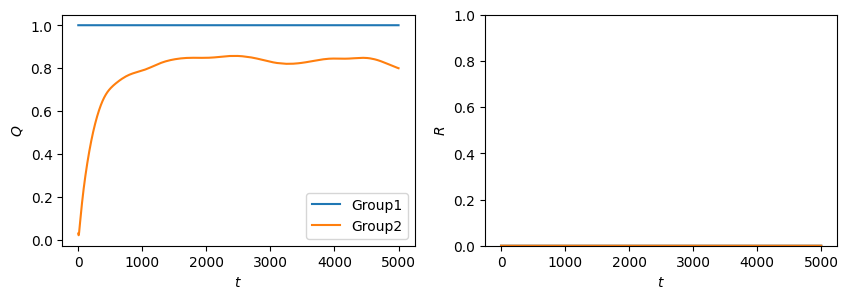

In [85]:
t = np.arange(0,5000,0.01)
# t = t*10
beta = 0.7
alpha = 0.8
K = 1
N1 = N2 = 200
Nt = N1+N2
R2,R1 = 0,0
Q2,Q1 = 0,0
# num = 0

while (abs(Q1-Q2)<0.1):
    np.random.seed(num)
    Theta = np.random.uniform(0,2*np.pi,Nt)
    # np.random.seed(num)
    # Theta[:N1] = np.random.uniform(0,2*np.pi,N1)
    
    # np.random.seed(num)
    # Theta[N1:] = np.random.uniform(0,2*np.pi,N2)
    
    # np.random.seed(num)
    # Theta[:N1//2] = np.random.uniform(0,np.pi,N1//2)
    # np.random.seed(num)
    # Theta[N1//2:N1] = np.random.uniform(np.pi,2*np.pi,N1//2)
    np.random.seed(num+1)
    Theta[N1:N1+N2//2] = np.random.uniform(0,np.pi,N1//2)
    np.random.seed(num+1)
    Theta[N1+N2//2:] = np.random.uniform(np.pi,2*np.pi,N1//2)
    
    Theta[N1//2:N1] = 0 + np.pi
    Theta[:N1//2] = 0
    sol,(Z1as,Z1bs,Z2as,Z2bs) = RK4_ZZ(Kuramoto_MF_CHIMERA,Theta,t,args=(N1,N2,beta,alpha,K))
    R1 = np.abs(Z1as[-1])
    R2 = np.abs(Z1bs[-1])
    Q1 = np.abs(Z2as[-1])
    Q2 = np.abs(Z2bs[-1])
    R1s.append(R1)
    R2s.append(R2)
    Q1s.append(Q1)
    Q2s.append(Q2)
    # print(R1,R2)
    print(Q1,Q2,np.abs(Q1-Q2))
    # num+=1 
    break

plt.figure(figsize=(10,3))
plt.subplot(121)
plt.plot(t,abs(Z2as),label='Group1')
plt.plot(t,abs(Z2bs),label='Group2')
plt.legend()
plt.ylabel(r'$Q$')
plt.xlabel(r'$t$')
# plt.ylim(0,1)
plt.subplot(122)
plt.plot(t,abs(Z1as))
plt.plot(t,abs(Z1bs))
plt.ylabel(r'$R$')
plt.xlabel(r'$t$')
plt.ylim(0,1)


plt.show()

In [68]:
((np.angle(Z2as)-np.angle(Z2bs))%np.pi)[-1]

2.6471157

In [69]:
np.abs(Z2bs[-1])

0.99999994

In [70]:
A1, = np.where(sol[:,N1:][-1]%(np.pi*2)>=np.pi)
A2, = np.where(sol[:,N1:][-1]%(np.pi*2)<np.pi)

In [71]:
theta_a = sol[:,N1:][:,A1]
theta_b = sol[:,N1:][:,A2]

In [72]:
Z1a = np.mean(np.exp(theta_a*1j),axis=1)
Z1b = np.mean(np.exp(theta_b*1j),axis=1)

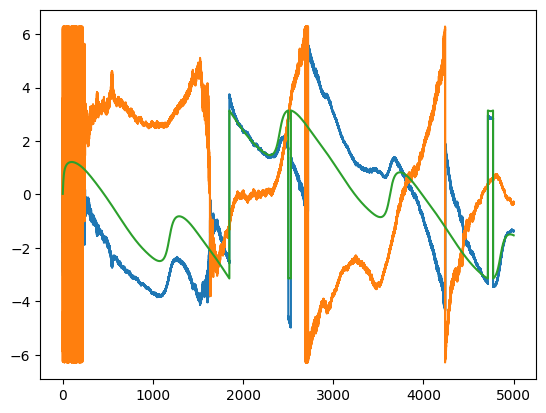

In [73]:
plt.plot(t,(np.angle(Z2as)-np.angle(Z1as)))
plt.plot(t,(2*np.angle(Z1as)))
plt.plot(t,(np.angle(Z2as)))

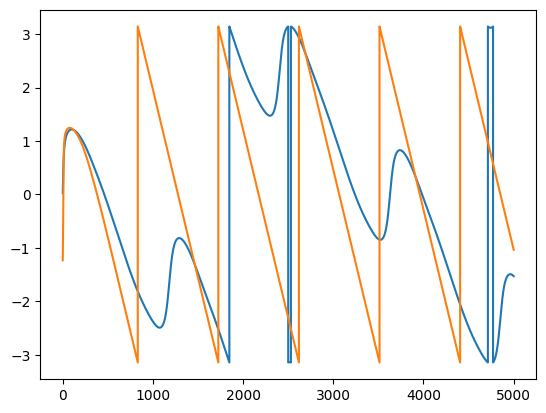

In [77]:
# plt.plot(t,-(np.angle(Z2bs)-np.angle(Z1bs)))
# plt.plot(t,(np.angle(Z1as**2)))
plt.plot(t,(np.angle(Z2as)))
plt.plot(t,(np.angle(Z2bs)))

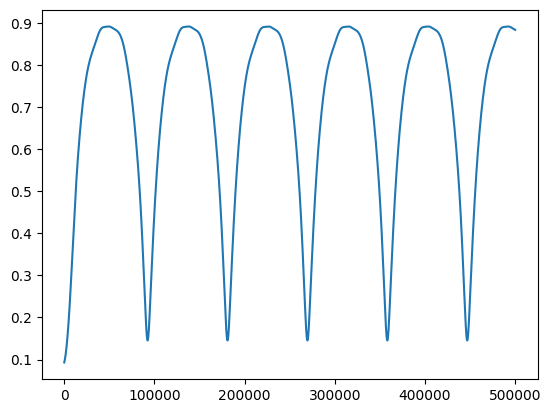

In [408]:
plt.plot(abs(Z2as))

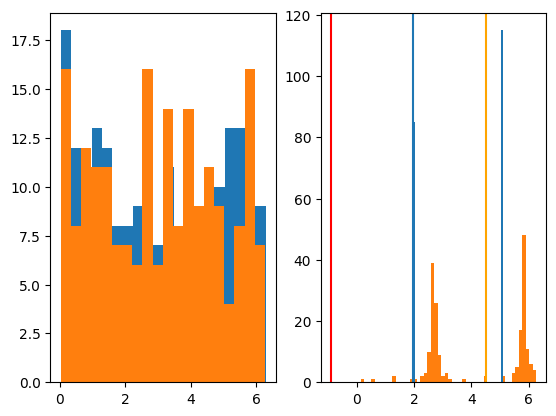

In [406]:
index = 10
plt.subplot(121)
plt.hist(Theta[N1:],bins=20)
plt.hist(Theta[:N1],bins=20)

plt.subplot(122)

plt.hist((sol[-index,N1:])%(np.pi*2),bins=50,zorder=2)
plt.hist(sol[-index,:N1]%(np.pi*2),bins=50)

plt.axvline(np.angle(Z2bs)[-1]%(np.pi*2)/2)
# plt.axvline(np.angle(Z1as)[-1],color='red')
plt.axvline(2*np.angle(Z1as)[-1],color='orange')
plt.axvline(np.angle(Z2as)[-1],color='red')
# plt.axvline(np.angle(Z1as)[-1]%(np.pi*2)/2)

(array([ 85.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,   0.,
          0.,   0.,   0.,   0.,   0.,   0.,   0.,   0., 115.]),
 array([1.96832565, 2.12540528, 2.28248491, 2.43956455, 2.59664418,
        2.75372381, 2.91080344, 3.06788308, 3.22496271, 3.38204234,
        3.53912197, 3.69620161, 3.85328124, 4.01036087, 4.16744051,
        4.32452014, 4.48159977, 4.6386794 , 4.79575904, 4.95283867,
        5.1099183 ]),
 <BarContainer object of 20 artists>)

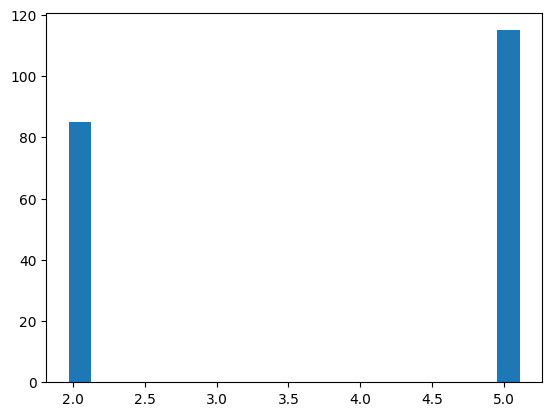

In [369]:
plt.hist((sol[-1,N1:])%(np.pi*2),bins=20,zorder=2)


In [345]:
def dist(x,a,c):
    a_ = a/(1-a*np.exp(2j*x))
    c_ = (c*np.exp(1j*x))/(1-c*np.exp(2j*x))
    f = 1/(2*np.pi) * (1+a_+c_ + np.conj(a_)+np.conj(c_))
    return f
xs = np.linspace(0,np.pi*2,1000)

In [346]:
np.angle(Z2bs)[-1]#%(np.pi*2)# - np.angle(Z2as)[-1]%(np.pi*2)/2

-3.121639

In [370]:
QB = np.abs(Z2bs[-1])
RB = np.abs(Z1bs[-1])
QB_angle = np.angle(Z2bs[-1])
RB_angle = np.angle(Z1bs[-1])

QA = np.abs(Z2as[-1])
RA = np.abs(Z1as[-1])
QA_angle = np.angle(Z2as[-1])
RA_angle = np.angle(Z1as[-1])

Z2A = QA*np.exp(-1j*(np.angle(Z2as)[-1]%(np.pi*2)))
Z2B = QB*np.exp(-1j*(np.angle(Z2bs)[-1]%(np.pi*2)))
Z1A = RA*np.exp(-1j*(0.5*np.angle(Z2as)[-1]%(np.pi*2)))
Z1B = RB*np.exp(-1j*(0.5*np.angle(Z2bs)[-1]%(np.pi*2)))

(0.0, 1.0)

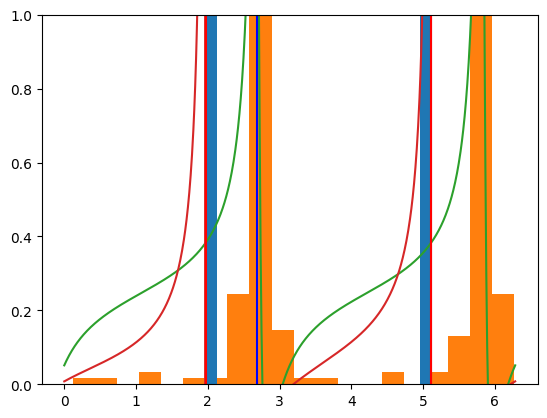

In [371]:
plt.hist((sol[-1,N1:])%(np.pi*2),bins=20,zorder=2,density=True)
plt.hist(sol[-1,:N1]%(np.pi*2),bins=20,density=True)
plt.plot(xs,dist(xs,Z2as[-1].conjugate(),Z1as[-1].conjugate()/2))
plt.plot(xs,dist(xs,Z2bs[-1].conjugate(),Z1bs[-1].conjugate()/2))
plt.axvline(np.angle(Z2as)[-1]%(np.pi*2)/2,color='blue')
plt.axvline(np.angle(Z2bs)[-1]%(np.pi*2)/2,color='red')
plt.axvline(np.angle(Z2bs)[-1]%(np.pi*2)/2+np.pi,color='red')

plt.ylim(0,1)

In [ ]:
for index in range(1,50000,5000):
    num_bin = 50
    bins = np.linspace(0,2*np.pi,num_bin+1)
    bin_ = np.linspace(0,2*np.pi,num_bin)
    cs1,_ = np.histogram(sol[-index,:N1]%(np.pi*2),bins=bins,density=True)
    cs2,_ = np.histogram(sol[-index,N1:]%(np.pi*2),bins=bins,density=True)
    cs1 = cs1 / np.max(cs1)
    cs2 = cs2 / np.max(cs2)


    bottom = 1
    max_height = 2
    radii1 = max_height*cs1
    radii2 = max_height*cs2
    width = (2*np.pi) / num_bin

    ax = plt.subplot(111, polar=True)
    bars1 = ax.bar(bin_, radii1, width=width, bottom=bottom)
    # bars2 = ax.bar(bin_, radii2, width=width, bottom=bottom)

    # Use custom colors and opacity
    for r, bar in zip(radii1, bars1):
        bar.set_facecolor(plt.cm.jet(r/5))
        bar.set_alpha(0.8)

    # for r, bar in zip(radii2, bars2):
    #     bar.set_facecolor(plt.cm.jet_r(r/5))
    #     bar.set_alpha(0.8)

    plt.show()

In [401]:
len(sol)

500000

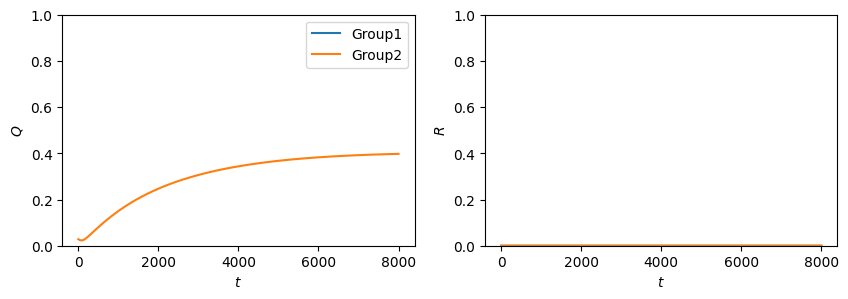

In [172]:

plt.figure(figsize=(10,3))
plt.subplot(121)
plt.plot(t,abs(Z2as),label='Group1')
plt.plot(t,abs(Z2bs),label='Group2')
plt.legend()
plt.ylabel(r'$Q$')
plt.xlabel(r'$t$')
plt.ylim(0,1)
plt.subplot(122)
plt.plot(t,abs(Z1as))
plt.plot(t,abs(Z1bs))
plt.ylabel(r'$R$')
plt.xlabel(r'$t$')
plt.ylim(0,1)

plt.show()

In [10]:
theta1s =  sol[:,:N1]
theta2s = sol[:,N1:]

In [11]:
sol[:,:N1]

array([[ 0.77682878,  6.15501902,  4.79952621, ...,  3.02707658,
         2.83580422,  3.13056235],
       [ 0.77683479,  6.15503047,  4.79951207, ...,  3.02708827,
         2.83581183,  3.13057557],
       [ 0.77684079,  6.15504192,  4.79949792, ...,  3.02709996,
         2.83581944,  3.13058879],
       ...,
       [-2.18530063,  4.09694039,  0.95863204, ...,  0.95536575,
         0.95507871,  0.95549363],
       [-2.18535229,  4.09688885,  0.95858008, ...,  0.95531421,
         0.9550272 ,  0.95544208],
       [-2.18540395,  4.09683732,  0.95852812, ...,  0.95526267,
         0.9549757 ,  0.95539052]])

In [30]:
theta1 =  sol[-1,:N1]
theta2 = sol[-1,N1:]
# plt.plot(sol[-1,:100])

In [13]:
Z1 = theta1
arg1a, = np.where(Z1%(np.pi*2)<np.pi)
arg1b, = np.where(Z1%(np.pi*2)>=np.pi)
A1 = np.where(Z1%(np.pi*2)<np.pi,np.nan,Z1)
B1 = np.where(Z1%(np.pi*2)>=np.pi,np.nan,Z1)
A1 = A1[~np.isnan(A1)]
B1 = B1[~np.isnan(B1)]

Z2 = theta2
arg2a, = np.where(Z2%(np.pi*2)<np.pi)
arg2b, = np.where(Z2%(np.pi*2)>=np.pi)
A2 = np.where(Z2%(np.pi*2)<np.pi,np.nan,Z2)
B2 = np.where(Z2%(np.pi*2)>=np.pi,np.nan,Z2)
A2 = A2[~np.isnan(A2)]
B2 = B2[~np.isnan(B2)]

print(len(A1),len(A2),len(B1),len(B2))

240 246 260 254


In [14]:
Az1 = 2/N1*(np.sum(np.exp(A1*1j)))
Bz1 = 2/N1*(np.sum(np.exp(B1*1j)))
Az2 = 2/N2*(np.sum(np.exp(A2*1j)))
Bz2 = 2/N2*(np.sum(np.exp(B2*1j)))

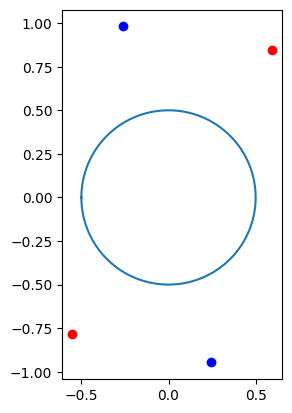

In [15]:
plt.gca().set_aspect(1)
plt.scatter(Az1.real,Az1.imag,color='red')
plt.scatter(Bz1.real,Bz1.imag,color='red')

plt.scatter(Az2.real,Az2.imag,color='blue')
plt.scatter(Bz2.real,Bz2.imag,color='blue')
x_ = np.linspace(-np.pi,np.pi,1000)
plt.plot(np.cos(x_)*0.5,np.sin(x_)*0.5)

In [15]:
theta1as = theta1s[:,arg1a]
theta1bs = theta1s[:,arg1b]

theta2as = theta2s[:,arg2a]
theta2bs = theta2s[:,arg2b]

NameError: name 'theta1s' is not defined

In [16]:
Az1s = 1/N1*(np.sum(np.exp(theta1as*1j),axis=(1)))
Bz1s = 1/N1*(np.sum(np.exp(theta1bs*1j),axis=(1)))
Az2s = 1/N2*(np.sum(np.exp(theta2as*1j),axis=(1)))
Bz2s = 1/N2*(np.sum(np.exp(theta2bs*1j),axis=(1)))

NameError: name 'theta1as' is not defined

In [17]:
plt.plot(abs(Az1s)-abs(Bz1s))
plt.plot(abs(Az2s)-abs(Bz2s))
# plt.plot(Az2s.real-Bz2s.real)

NameError: name 'Az1s' is not defined

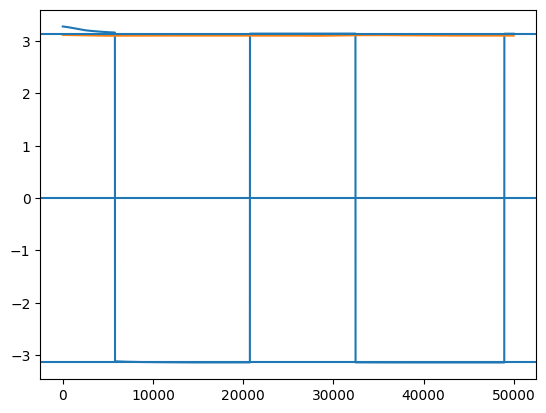

In [318]:
plt.plot(np.angle(Az1s)-np.angle(Bz1s))
plt.plot(np.angle(Az2s)-np.angle(Bz2s))
plt.axhline(0)
plt.axhline(np.pi)
plt.axhline(-np.pi)
# plt.plot(Az2s.real-Bz2s.real)

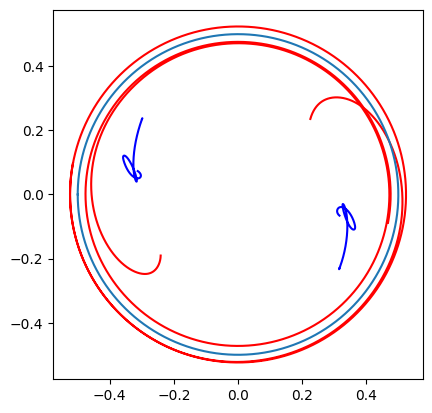

In [319]:
plt.gca().set_aspect(1)
plt.plot(Az1s.real,Az1s.imag,color='red')
plt.plot(Bz1s.real,Bz1s.imag,color='red')
plt.plot(Az2s.real,Az2s.imag,color='blue')
plt.plot(Bz2s.real,Bz2s.imag,color='blue')
x_ = np.linspace(-np.pi,np.pi,1000)
plt.plot(np.cos(x_)*0.5,np.sin(x_)*0.5)

In [68]:
theta1bs.shape

(50000, 1, 251)

In [48]:
np.angle(Az1)-np.angle(Bz1)

-3.1415929892064027

In [47]:
np.angle(Z2as[-1])

-2.9909506

In [13]:
np.abs(Az1) + np.abs(Bz1)

0.8281869882725807

In [10]:
Az1**2+Bz1**2

(-0.33956594030926107-0.047061179464538944j)

In [60]:
np.angle(Az1**2+Bz1**2)

1.7500750318127327

In [61]:
np.exp(theta1*1j)

array([-0.80827786-0.58880123j, -0.60366002-0.79724186j,
        0.58752076+0.80920909j, ..., -0.99466375-0.10316989j,
       -0.86658898-0.49902258j,  0.39231549-0.91983072j])

In [20]:
deg_2 = np.deg2rad(np.angle(Z2as[-1]))
deg_1 = np.deg2rad(np.angle(Z2bs[-1]))

RuntimeError: Optimal parameters not found: Number of calls to function has reached maxfev = 1400.

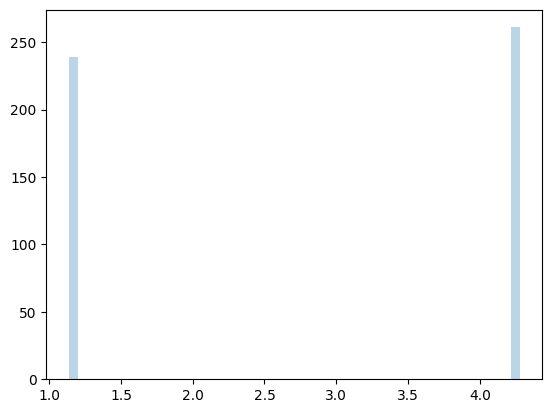

In [22]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.optimize import curve_fit

#data generation
np.random.seed(123)
data= (theta2+np.pi/2+0.5)%(2*np.pi)
y,x,_=plt.hist(data, 50, alpha=.3, label='data')
x=(x[1:]+x[:-1])/2 # for len(x)==len(y)

#x, y inputs can be lists or 1D numpy arrays

def gauss(x, mu, sigma, A):
    return A*np.exp(-(x-mu)**2/2/sigma**2)

def bimodal(x, mu1, sigma1, A1, mu2, sigma2, A2):
    return gauss(x,mu1,sigma1,A1)+gauss(x,mu2,sigma2,A2)

expected = (np.pi/2, .2, 250, 3*np.pi/2, .2, 250)
params, cov = curve_fit(bimodal, x, y, expected)
sigma=np.sqrt(np.diag(cov))
x_fit = np.linspace(x.min(), x.max(), 500)
#plot combined...
plt.plot(x_fit, bimodal(x_fit, *params), color='red', lw=3, label='model')
#...and individual Gauss curves
plt.plot(x_fit, gauss(x_fit, *params[:3]), color='red', lw=1, ls="--", label='distribution 1')
plt.plot(x_fit, gauss(x_fit, *params[3:]), color='red', lw=1, ls=":", label='distribution 2')
#and the original data points if no histogram has been created before
#plt.scatter(x, y, marker="X", color="black", label="original data")
plt.legend()
print(pd.DataFrame(data={'params': params, 'sigma': sigma}, index=bimodal.__code__.co_varnames[1:]))
plt.show() 

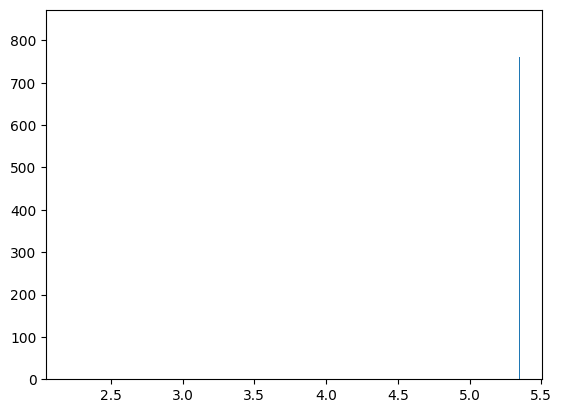

In [23]:
beta,b,_ = plt.hist(np.unique(theta2%(2*np.pi)) ,bins=5000,density=True)

In [24]:
(3.05080003e+00 -6.19118943e+00)

-3.1403893999999997

In [25]:
b_ = np.argsort(beta)[::-1]
b[b_]

array([2.20642267, 5.34738932, 5.34613268, ..., 4.3012382 , 4.30186652,
       3.77659184])

In [26]:
6.19620402 - 3.05456097

3.14164305

In [27]:
4.43425983e-03

0.00443425983

In [28]:
abs(3.06201411 -6.220311) - np.pi

0.016704236410206796

In [14]:
plt.hist(theta1%(np.pi*2),bins=30,density=False,label='Group1');
plt.hist(theta2%(np.pi*2),bins=30,density=False,label='Group2');
plt.legend()
# plt.axvline((deg_2))

NameError: name 'theta1' is not defined

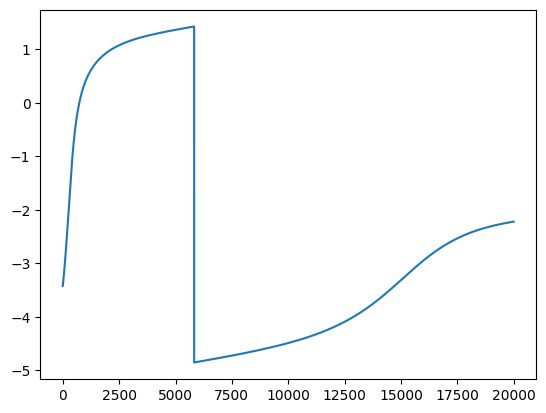

In [484]:
plt.plot(np.angle(Z2as)-np.angle(Z2bs))

# plt.plot(np.angle(Z1as)-np.angle(Z1bs))

In [4]:
def get_MS(Z):
    Z = Z[-1000:]
    R = np.abs(Z)
    M = np.mean(R)
    S = np.std(R)
    return M,S
def get_Zinfo(Zs):
    MS = []
    SS = []
    for Z in Zs:
        M,S = get_MS(Z)
        MS.append(M)
        SS.append(S)
    return MS,SS

In [25]:
t = np.arange(0,2000,0.1)
# t = t*10
beta = 0.5
alpha = 1.0

N1 = N2 = 200
Nt = N1+N2
K = 1


RM_DICT,RS_DICT = {},{}
QM_DICT,QS_DICT = {},{}

# MSs,SSs = MSs.tolist(),SSs.tolist()
# Ra_M,Rb_M = [],[]
# Qa_M,Qb_M = [],[]
# Ra_S,Rb_S = [],[]
# Qa_S,Qb_S = [],[]
T = 10
As = np.linspace(0,1,11)[1:]
Alphas = np.linspace(0,np.pi/2,10)[:]
for alpha in tqdm(Alphas):
    for beta in As:
        MSs,SSs = [],[]
        for i in range(T):
            np.random.seed(i)
            Theta = np.random.uniform(0,2*np.pi,Nt)
            np.random.seed(i)
            Theta[:N1//2] = np.random.uniform(0,np.pi,N1//2)
            np.random.seed(i)
            Theta[N1//2:N1] = np.random.uniform(np.pi,2*np.pi,N1//2)
            np.random.seed(i+1)
            Theta[N1:N1+N2//2] = np.random.uniform(0,np.pi,N1//2)
            np.random.seed(i+1)
            Theta[N1+N2//2:] = np.random.uniform(np.pi,2*np.pi,N1//2)
            Theta[:N1//2] = 0
            Theta[N1//2:N1] = np.pi
            sol,Zs = RK4_ZZ(Kuramoto_MF_CHIMERA,Theta,t,args=(N1,N2,beta,alpha,K))
            MS,SS = get_Zinfo(Zs)
            MSs.append(MS)
            SSs.append(SS)
        MSs = np.array(MSs)
        SSs = np.array(SSs)
        RMs = np.sort(MSs[:,:2],axis=1)
        QMs = np.sort(MSs[:,2:],axis=1)

        R_arg = np.argsort(MSs[:,:2],axis=1)
        Q_arg = np.argsort(MSs[:,2:],axis=1)
        RSs = np.array([SSs[i,:2][arg] for i,arg in enumerate(R_arg)])
        QSs = np.array([SSs[i,2:][arg] for i,arg in enumerate(Q_arg)])
        QS_DICT[beta,alpha] = QSs
        QM_DICT[beta,alpha] = QMs
        RS_DICT[beta,alpha] = RSs
        RM_DICT[beta,alpha] = RMs
        

  0%|          | 0/10 [00:00<?, ?it/s]

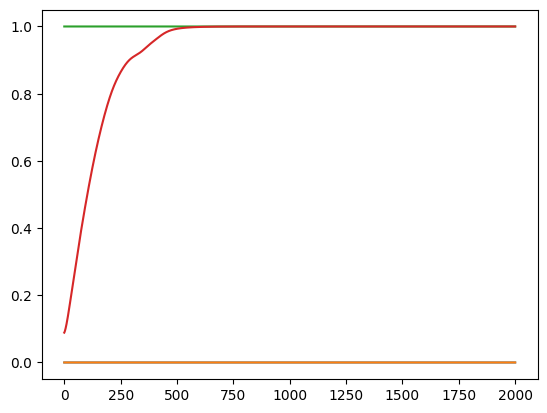

In [26]:
plt.plot(t,np.abs(Zs[0]))
plt.plot(t,np.abs(Zs[1]))
plt.plot(t,np.abs(Zs[2]))
plt.plot(t,np.abs(Zs[3]))

  0%|          | 0/10 [00:00<?, ?it/s]

R 0.1 0.0
R 0.2 0.0
R 0.30000000000000004 0.0
R 0.4 0.0
R 0.5 0.0
R 0.6000000000000001 0.0
R 0.7000000000000001 0.0
R 0.8 0.0
R 0.9 0.0
R 1.0 0.0
R 0.1 0.17453292519943295
R 0.2 0.17453292519943295
R 0.30000000000000004 0.17453292519943295
R 0.4 0.17453292519943295
R 0.5 0.17453292519943295
R 0.6000000000000001 0.17453292519943295
R 0.7000000000000001 0.17453292519943295
R 0.8 0.17453292519943295
R 0.9 0.17453292519943295
R 1.0 0.17453292519943295
R 0.1 0.3490658503988659
R 0.2 0.3490658503988659
R 0.30000000000000004 0.3490658503988659
R 0.4 0.3490658503988659
R 0.5 0.3490658503988659
R 0.6000000000000001 0.3490658503988659
R 0.7000000000000001 0.3490658503988659
R 0.8 0.3490658503988659
R 0.9 0.3490658503988659
R 1.0 0.3490658503988659
R 0.1 0.5235987755982988
R 0.2 0.5235987755982988
R 0.30000000000000004 0.5235987755982988
R 0.4 0.5235987755982988
R 0.5 0.5235987755982988
R 0.6000000000000001 0.5235987755982988
R 0.7000000000000001 0.5235987755982988
R 0.8 0.5235987755982988
R 0.9 

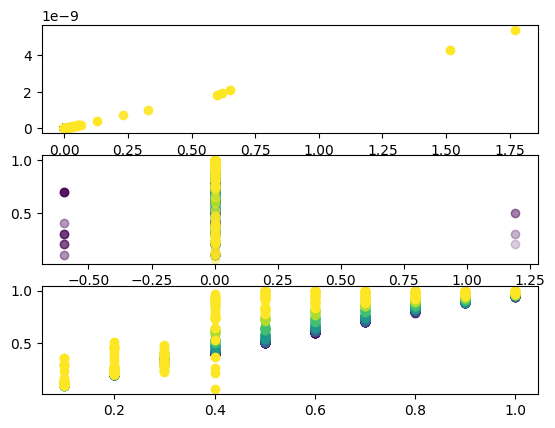

In [54]:
QM1_alpha = []
RM1_alpha = []
QM2_alpha = []
RM2_alpha = []


QS2_alpha = []
RS2_alpha = []


colors = plt.cm.viridis(Alphas)
color_dict = dict(zip(Alphas,colors))
for alpha in tqdm(Alphas):
    QM1 = [] 
    RM1 = [] 
    QM2 = [] 
    QS2 = []

    RM2 = []  
    RS2 = []
    for beta in As:
        QSs = QS_DICT[beta,alpha]
        QMs = QM_DICT[beta,alpha]
        RMs = RM_DICT[beta,alpha]
        RSs = RS_DICT[beta,alpha]
        Q2 = QMs[:,0]
        Qs2 = QSs[:,0]
        R2 = RMs[:,0]
        Rs2 = RSs[:,0]

        Q1 = QMs[:,1]
        R1 = RMs[:,1]
        Q_qulify = np.where(Q1>0.99,Q2,np.nan)
        R_qulify = np.where(R1>0.98,R2,np.nan)
        try:
            Q_qulify = np.where(Q_qulify<0.9999,Q_qulify,np.nan)
            Qarg = np.nanargmin(Q_qulify)
            QM1.append(Q1[Qarg])
            QM2.append(Q2[Qarg])
            QS2.append(Qs2[Qarg])

        except ValueError:
            print('Q',beta,alpha)
            QM1.append(np.nan)
            QM2.append(np.nan)
            QS2.append(np.nan)

        try:
            Rarg = np.nanargmin(R_qulify)
            RM1.append(R1[Rarg])
            RM2.append(R2[Rarg])
            RS2.append(Rs2[Rarg])
        except ValueError:
            print('R',beta,alpha)


            RM1.append(np.nan)
            RM2.append(np.nan)
            RS2.append(np.nan)
        
        RSs = RS_DICT[beta,alpha]
        RMs = RM_DICT[beta,alpha]
        plt.subplot(311)
        plt.scatter(RMs[:,0],RMs[:,1],color=color_dict[alpha],alpha=beta)
        plt.subplot(312)
        plt.scatter(Q1,Q2,color=color_dict[alpha],alpha=beta)
        # plt.scatter(a*np.ones_like(Q_qulify),Q_qulify,color=color_dict[alpha])

        plt.subplot(313)
        plt.scatter(beta*np.ones_like(Q_qulify),Q_qulify,color=color_dict[alpha])
    QM1_alpha.append(QM1)
    RM1_alpha.append(RM1)
    QM2_alpha.append(QM2)
    QS2_alpha.append(QS2)
    RM2_alpha.append(RM2)
    RS2_alpha.append(RS2)


QM1_alpha = np.array(QM1_alpha)
RM1_alpha = np.array(RM1_alpha)
QM2_alpha = np.array(QM2_alpha)
RM2_alpha = np.array(RM2_alpha)
QS2_alpha = np.array(QS2_alpha)
# RS2_alpha = np.array(RS2_alpha)


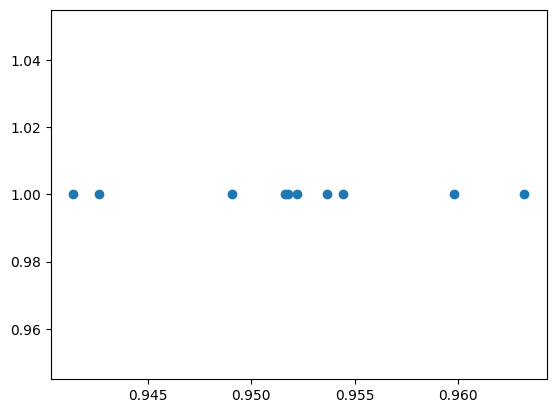

In [55]:
x,y = QM_DICT[As[-1],Alphas[1]].T
plt.scatter(x,y)

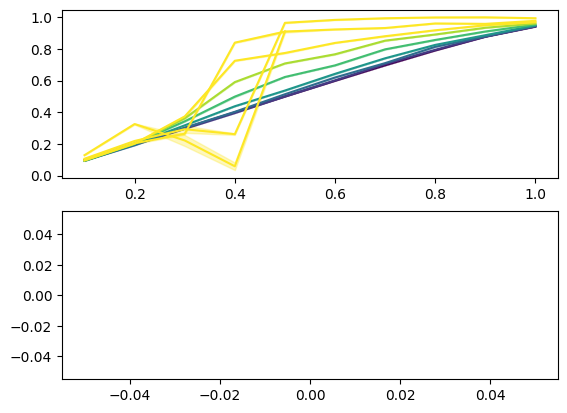

In [61]:

for i,alpha in enumerate(Alphas):
    plt.subplot(211)
    plt.plot(As,QM2_alpha[i],color=color_dict[alpha])
    plt.fill_between(As,QM2_alpha[i]-QS2_alpha[i],QM2_alpha[i]+QS2_alpha[i],color=color_dict[alpha],alpha=0.3)

    plt.subplot(212)
    plt.plot(As,RM2_alpha[i],color=color_dict[alpha])


In [58]:
QM2_alpha.shape

(10, 10)

In [59]:
BB,AA = np.meshgrid(As,Alphas)

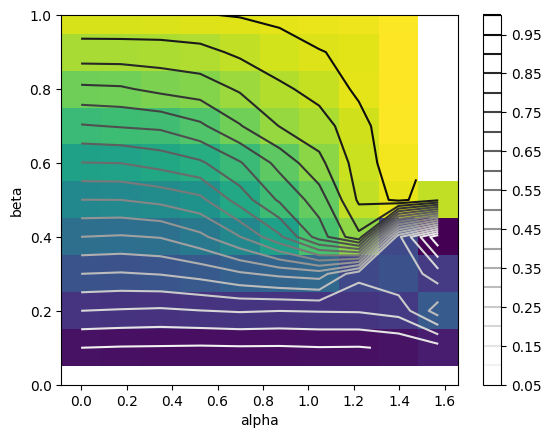

In [60]:
# plt.imshow(QM2_alpha.T,extent=[0,1.6,0.1,1],origin='lower')
plt.pcolormesh(AA,BB,QM2_alpha)
plt.contour(AA,BB,QM2_alpha,levels=21,origin='lower',cmap='gray_r')

plt.ylim(0,1)
# plt.contour(QM2_alpha.T,extent=[0,1.6,Alphas[0],Alphas[-1]],levels=21,origin='lower')
plt.ylabel('beta')
plt.xlabel('alpha')
plt.colorbar()
# plt.tight_layout()

/var/folders/lj/v2s5sd8n1cv2xdh0yw2kf0x00000gn/T/ipykernel_87573/1877093551.py:2: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(121)


Text(0, 0.5, 'alpha')

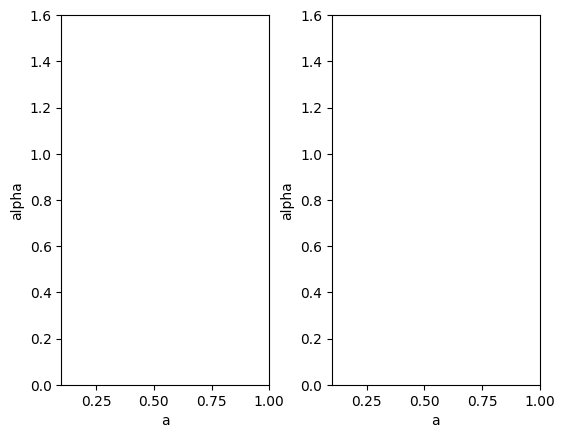

In [12]:
ax =  plt.subplot(111)
plt.subplot(121)
plt.imshow(RS2_alpha,extent=[0.1,1,0,1.6],origin='lower')
plt.xlabel('a')
plt.ylabel('alpha')

plt.subplot(122)
plt.imshow(RM2_alpha,extent=[0.1,1,0,1.6],origin='lower')
plt.xlabel('a')
plt.ylabel('alpha')



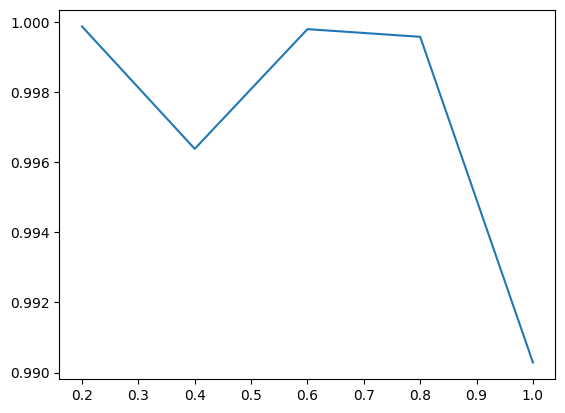

In [25]:
plt.plot(As,QM1)

In [28]:
MSs = np.array(MSs)
SSs = np.array(SSs)
RMs = np.sort(MSs[:,:2],axis=1)
QMs = np.sort(MSs[:,2:],axis=1)

R_arg = np.argsort(MSs[:,:2],axis=1)
Q_arg = np.argsort(MSs[:,2:],axis=1)
RSs = np.array([SSs[i,:2][idx] for i,idx in enumerate(R_arg)])
QSs = np.array([SSs[i,:2][idx] for i,idx in enumerate(Q_arg)])

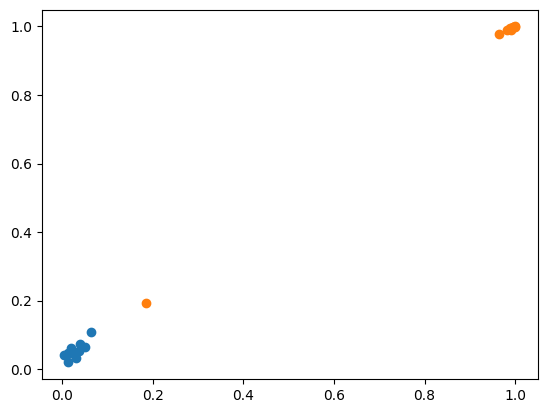

In [29]:
plt.scatter(RMs[:,0],RMs[:,1])
plt.scatter(QMs[:,0],QMs[:,1])

In [23]:
plt.hist2d(QMs[:,0],QSs[:,0],color=mpl.colors.lognorm())

AttributeError: module 'matplotlib.colors' has no attribute 'lognorm'

(array([[2., 2., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 5., 5., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 4., 4., 0., 0., 0., 0., 0., 0.],
        [0., 3., 2., 1., 0., 0., 0., 0., 0., 0.],
        [1., 1., 1., 1., 3., 0., 0., 0., 0., 0.],
        [0., 0., 0., 1., 1., 2., 1., 0., 0., 0.],
        [2., 1., 0., 0., 0., 0., 1., 0., 0., 0.],
        [0., 0., 0., 0., 1., 0., 0., 1., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 1., 0.],
        [0., 0., 0., 0., 1., 0., 0., 0., 0., 1.]]),
 array([0.01655907, 0.03048501, 0.04441096, 0.0583369 , 0.07226284,
        0.08618879, 0.10011473, 0.11404068, 0.12796662, 0.14189256,
        0.15581851]),
 array([0.00125224, 0.00316326, 0.00507428, 0.0069853 , 0.00889632,
        0.01080733, 0.01271835, 0.01462937, 0.01654039, 0.01845141,
        0.02036243]),
 <matplotlib.collections.QuadMesh at 0x142b8df10>)

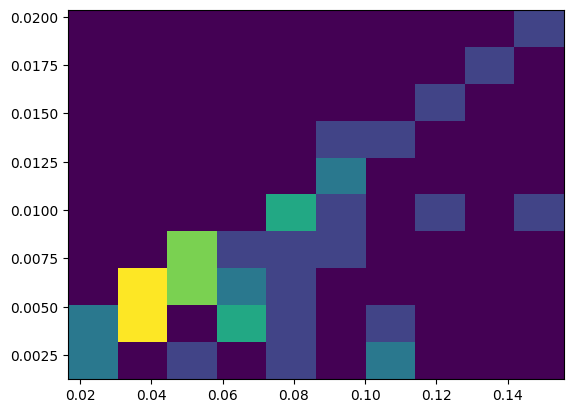

In [24]:
plt.hist2d(QMs[:,0],QSs[:,1])

Text(0, 0.5, ' oscillator')

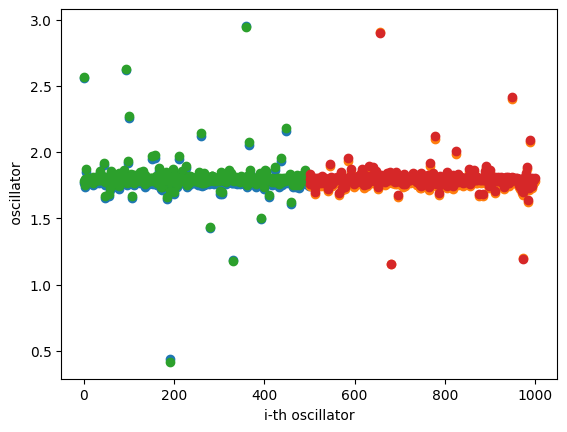

In [32]:
# plt.scatter(np.arange(N),np.sort(sol[-1][:N]%(np.pi)))
# plt.scatter(np.arange(N)+N,np.sort(sol[-1][N:]%(np.pi)))

SS = N1
plt.scatter(np.arange(SS),sol[-1][:SS]%(np.pi))
plt.scatter(np.arange(2*N1-SS)+SS,sol[-1][SS:]%(np.pi))

idx = -1000
plt.scatter(np.arange(SS),sol[idx][:SS]%(np.pi))
plt.scatter(np.arange(2*N1-SS)+SS,sol[idx][SS:]%(np.pi))

# plt.scatter(np.arange(SS),sol[-20][:SS]%(np.pi))
# plt.scatter(np.arange(2*N-SS)+SS,sol[-20][SS:]%(np.pi))

# plt.plot(sol[-1]%(2*np.pi),'.')
plt.xlabel('i-th oscillator')
plt.ylabel(' oscillator')

([<matplotlib.axis.XTick at 0x10d49c410>,
 [Text(0, 0, '0'),
  Text(250, 0, 'Group1'),
  Text(500, 0, '500'),
  Text(750, 0, 'Group2'),
  Text(1000, 0, '1000')])

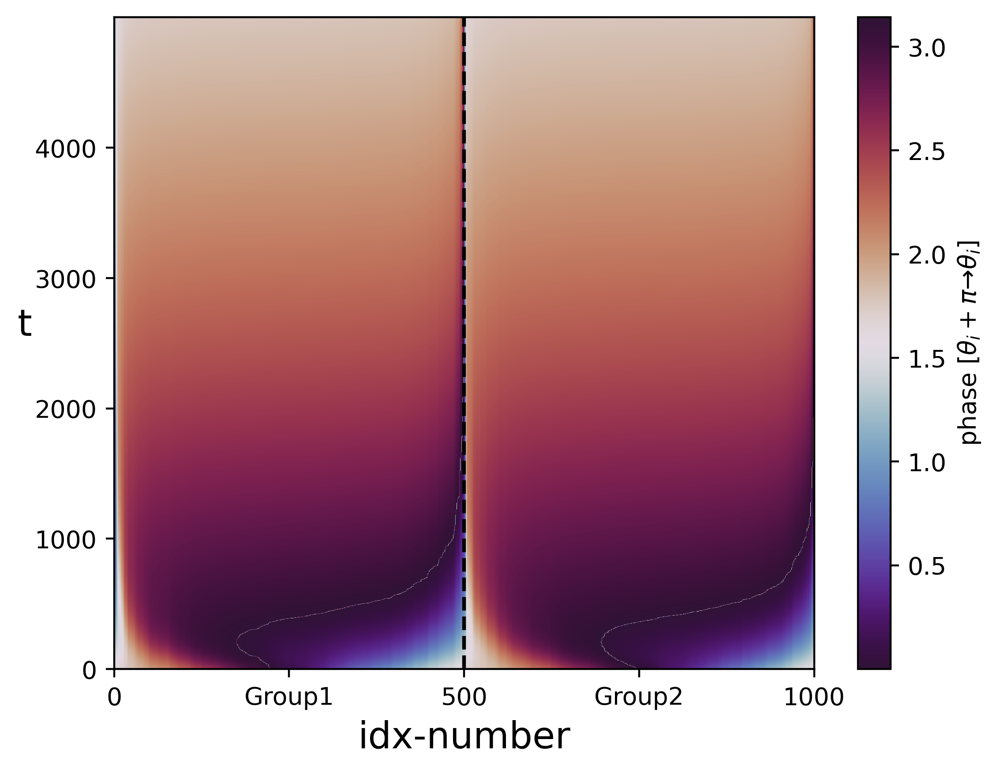

In [33]:
G1 =  np.argsort(sol[-1][:N1]%(np.pi))
G2 =  np.argsort(sol[-1][N1:]%(np.pi))
SG12 = np.array([*G1,*(N1+G2)])
# plt.imshow((sol[-300:,:])%np.pi,origin='lower',cmap='twilight_shifted',aspect='auto')
plt.figure(dpi=400)
# plt.imshow(sol[-300:,SG12]%np.pi,origin='lower',cmap='twilight_shifted',aspect='auto',extent=[0,2*N,t[-300],t[-1]])
plt.imshow(sol[0:-1,SG12]%(np.pi),origin='lower',cmap='twilight_shifted',aspect='auto',extent=[0,2*N1,t[0],t[-1]])
cbar = plt.colorbar()
cbar.set_label(r'phase [$\theta_i+\pi\to\theta_i$]')

plt.axvline(N1,color='black',ls='--')
plt.ylabel('t',rotation=0,fontsize=15)
plt.xlabel('idx-number',fontsize=15)
plt.xticks([0,N1//2,N1,N1+(N1//2),2*N1],[0,'Group1',N1,'Group2',2*N1])


# plt.imshow(sol[:]%np.pi,origin='lower',cmap ='hsv')


(-1.0999986402114572,
 1.0999986402114572,
 -1.0999997527658723,
 1.0999948080833182)

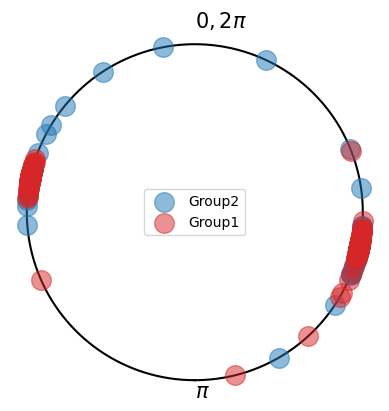

In [34]:
x = np.linspace(-np.pi,np.pi,1000)
fig = plt.figure()
ax =plt.gca()
ax.set_aspect(1)
ax.plot(np.sin(x),np.cos(x),color='k',zorder=-10)
idx= -2;
sca2 = ax.scatter(np.sin(sol[idx][:SS]),np.cos(sol[idx][:SS]),color='tab:blue',label='Group2',s=200,alpha=0.5)
sca1 = ax.scatter(np.sin(sol[idx][SS:]),np.cos(sol[idx][SS:]),color='tab:red',label='Group1',s=200,alpha=0.5)
ax.legend()
# idx= -1;plt.scatter(np.sin(sol[idx]),np.cos(sol[idx]))
# idx= 110;plt.scatter(np.sin(sol[-idx]),np.cos(sol[-idx]))
plt.text(0,1.1,r'$0,2\pi$',fontsize=15)
plt.text(0,-1.1,r'$\pi$',fontsize=15)
plt.axis('off')

In [462]:
def FOR_DATA(sol):
    DATA1 = list(zip(np.cos(sol[:,:SS]),np.sin(sol[:,:SS])))
    DATA2 = list(zip(np.cos(sol[:,SS:]),np.sin(sol[:,SS:])))
    DATA1 = [list(zip(*data)) for data in DATA1] 
    DATA2 = [list(zip(*data)) for data in DATA2]
    return DATA1,DATA2 

DATA1,DATA2 = FOR_DATA(sol)

def get_ani(idx):
    sca1.set_offsets(DATA1[idx])
    sca2.set_offsets(DATA2[idx])

len(t)
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128
%config InlineBackend.figure_format = 'retina'
idxs=  np.arange(0,30000,100)
ani = FuncAnimation(fig,get_ani,frames=idxs,interval=50)
len(t)
HTML(ani.to_jshtml())
# ani.save(rf'HIGH ORDER CHIMERA/SB_B 2pi N={N},mu={mu:.01f},nu={nu:.01f},xi={xi:.01f},beta={beta:.01f}.mp4',dpi=300)

(-1.0999986402114572,
 1.0999986402114572,
 -1.0999997527658723,
 1.0999948080833182)

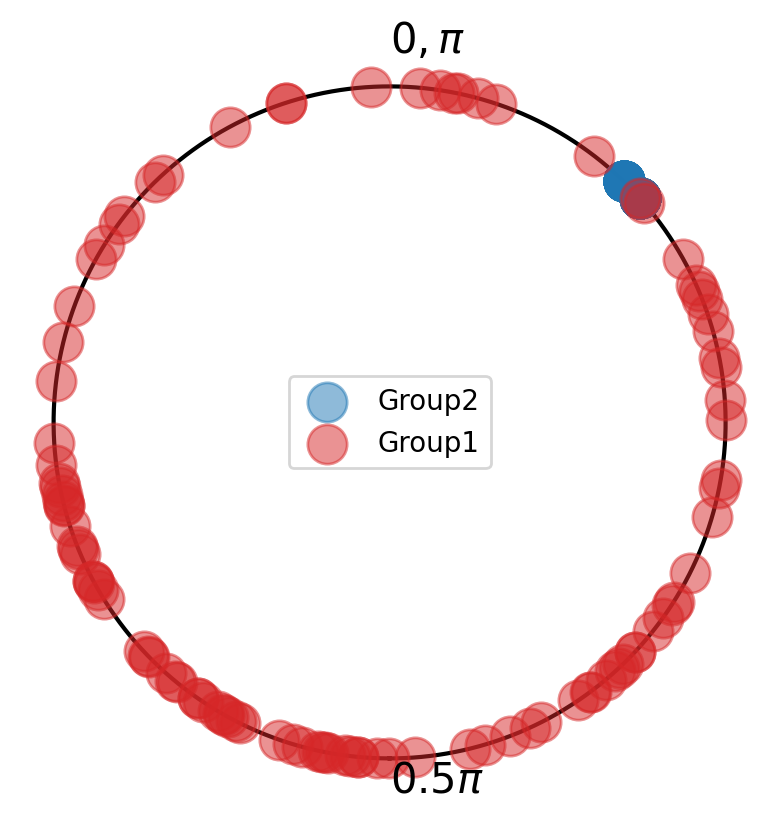

In [463]:
x = np.linspace(-np.pi,np.pi,1000)
fig = plt.figure()
plt.axes().set_aspect(1)
plt.plot(np.sin(x),np.cos(x),color='k',zorder=-10)
ax = plt.gca()
idx= -1;
sca2 = ax.scatter(np.sin(2*sol[idx][:SS]),np.cos(2*sol[idx][:SS]),color='tab:blue',label='Group2',s=200,alpha=0.5)
sca1 = ax.scatter(np.sin(2*sol[idx][SS:]),np.cos(2*sol[idx][SS:]),color='tab:red',label='Group1',s=200,alpha=0.5)
plt.legend()
# idx= -1;plt.scatter(np.sin(sol[idx]),np.cos(sol[idx]))
# idx= 110;plt.scatter(np.sin(sol[-idx]),np.cos(sol[-idx]))

plt.text(0,1.1,r'$0,\pi$',fontsize=15)
plt.text(0,-1.1,r'$0.5\pi$',fontsize=15)
plt.axis('off')

In [464]:
# mask = [[for]]
def FOR_DATA(sol):
    DATA1 = list(zip(np.cos(2*sol[:,:SS]),np.sin(2*sol[:,:SS])))
    DATA2 = list(zip(np.cos(2*sol[:,SS:]),np.sin(2*sol[:,SS:])))
    DATA1 = [list(zip(*data)) for data in DATA1] 
    DATA2 = [list(zip(*data)) for data in DATA2]
    return DATA1,DATA2 

DATA1,DATA2 = FOR_DATA(sol)

def get_ani(idx):
    sca1.set_offsets(DATA1[idx])
    sca2.set_offsets(DATA2[idx])
%config InlineBackend.figure_format = 'retina'
idxs=  np.arange(0,30000,100)
ani = FuncAnimation(fig,get_ani,frames=idxs,interval=50)
HTML(ani.to_jshtml())

# ani.save(rf'HIGH ORDER CHIMERA/SB_B pi N={N},mu={mu:.01f},nu={nu:.01f},xi={xi:.01f},beta={beta:.01f}.mp4',dpi=300)

## Possion kernel

In [1]:
import numpy as np
import matplotlib.pyplot as plt

In [2]:
def P(theta,r):
    nu = 1 + r*np.exp(1j*theta)
    de = 1 - r*np.exp(1j*theta)
    return np.abs(nu/de) 

Text(0, 0.5, '$f(\\theta)$')

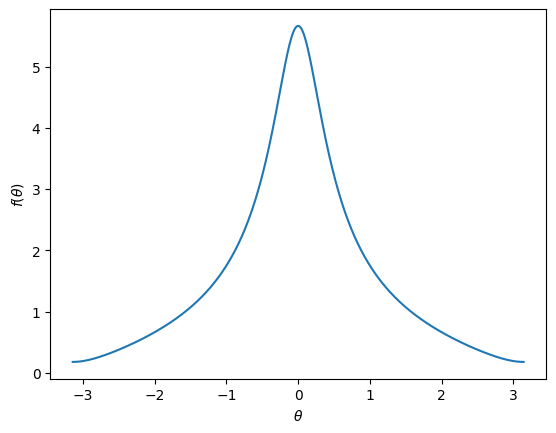

In [3]:
theta = np.linspace(-np.pi,np.pi,1000)
plt.plot(theta,P(theta,0.7))
plt.xlabel(r'$\theta$')
plt.ylabel(r'$f(\theta)$')

In [492]:
beta = 1+1j
beta.conjugate()

(1-1j)

In [4]:
def f_OA(theta,a):
    f1 = 1
    f2 = a*np.exp(1j*theta) / (1- a*np.exp(1j*theta))
    return np.abs(1/(np.pi*2)*(f1+f2+f2.conjugate()))


Text(0, 0.5, '$f(\\theta)$')

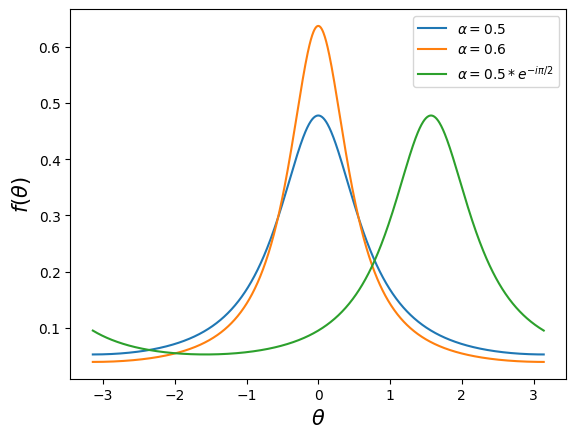

In [27]:
theta = np.linspace(-np.pi,np.pi,1000)
plt.plot(theta,f_OA(theta,0.5),label=r'$\alpha=0.5$')
plt.plot(theta,f_OA(theta,0.6),label=r'$\alpha=0.6$')
plt.plot(theta,f_OA(theta,0.5*np.exp(-0.5*np.pi*1j)),label=r'$\alpha=0.5*e^{-i\pi/2}$')
plt.legend()
plt.xlabel(r'$\theta$',fontsize=15)
plt.ylabel(r'$f(\theta)$',fontsize=15)